# Annotations using clustering for cells for pancreatic_s0

In [1]:
slide_id = "pancreatic_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_pancreatic_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 71883, 20562), (3, 35941, 10281)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (190965, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (190965, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (190965, 474)
      └── 'table_nuclei': AnnData (190965, 538)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 190965 × 474
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,143,0,0,0,0,143,172.225944,8.037813,cell_labels
1,aaaaaaab-1,112,0,0,0,0,112,334.517512,17.294844,cell_labels
2,aaaaaaac-1,81,0,0,0,0,81,180.263757,20.681563,cell_labels
3,aaaaaaad-1,30,0,0,0,0,30,43.891877,6.637969,cell_labels
4,aaaaaaae-1,92,0,0,0,0,92,140.255318,27.093751,cell_labels
...,...,...,...,...,...,...,...,...,...,...
190960,aaacojpa-1,133,0,0,0,0,133,111.219848,24.429532,cell_labels
190961,aaacojpb-1,69,0,0,0,0,69,111.039223,16.888438,cell_labels
190962,aaacojpc-1,124,0,0,0,0,124,187.579069,23.120001,cell_labels
190963,aaacojpd-1,242,0,0,0,0,242,236.167196,22.262032,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
VSIG4,ENSG00000155659,Gene Expression,Unknown
VTN,ENSG00000109072,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown
VWF,ENSG00000110799,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 175587 × 538
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,16.481947,Myofibroblast,24,1,0,3,3,Macrophage,Macrophage,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,19.349574,B cell,31,6,11,11,11,B,B,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.671157,CD8 T,64,2,5,6,6,T,T,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,20.162281,Endothelial cell,21,1,0,3,3,Macrophage,Macrophage,normal_cell
aaaaaaah-1,nucleus_boundaries,morpho,aaaaaaah-1,48.001261,Macrophage,121,1,6,3,3,Macrophage,Macrophage,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaacojpa-1,nucleus_boundaries,morpho,aaacojpa-1,22.465714,B cell,56,2,5,6,6,T,T,normal_cell
aaacojpb-1,nucleus_boundaries,morpho,aaacojpb-1,15.375449,CD4 T,31,2,5,6,6,T,T,normal_cell
aaacojpc-1,nucleus_boundaries,morpho,aaacojpc-1,20.792539,Endothelial cell,61,3,8,7,7,Endothelial,Endothelial,normal_cell
aaacojpd-1,nucleus_boundaries,morpho,aaacojpd-1,20.319223,Beta cell,63,2,5,6,6,T,T,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.004750,0.155302
ACE2,0.060050,0.546288
ACKR1,0.050316,0.512221
ACTA2,0.347225,1.333669
ACTG2,0.276639,1.161480
...,...,...
VSIG4,0.263987,1.161768
VTN,0.198235,0.975342
VWA5A,0.218750,1.019283
VWF,0.229407,1.092765


## 2. Preprocessing

<Axes: >

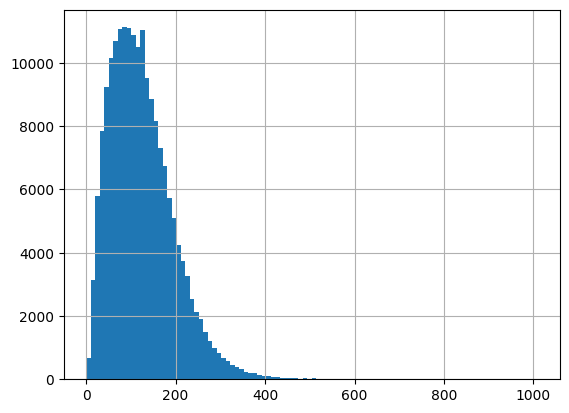

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

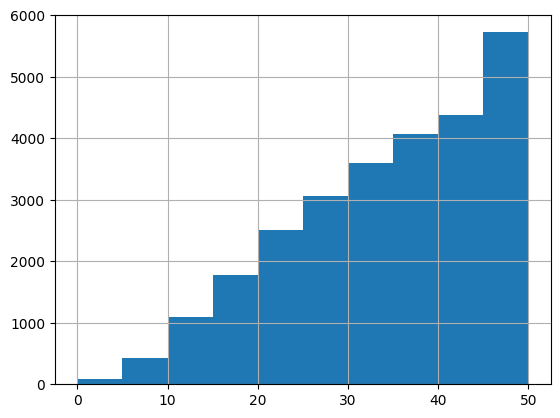

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 3372
Percentage of cells with less than 20 transcripts: 1.77%
-----
Number of cells with less than 15 transcripts: 1596
Percentage of cells with less than 15 transcripts: 0.84%
-----
Number of cells with less than 10 transcripts: 510
Percentage of cells with less than 10 transcripts: 0.27%
-----
Number total of cells: 190965


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

190294


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


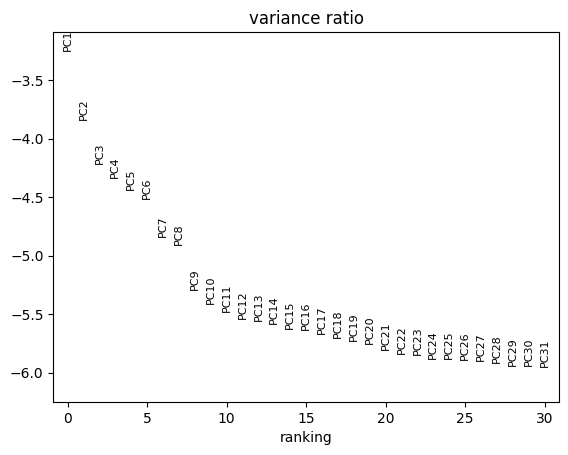

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 190294 × 474
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_3456/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


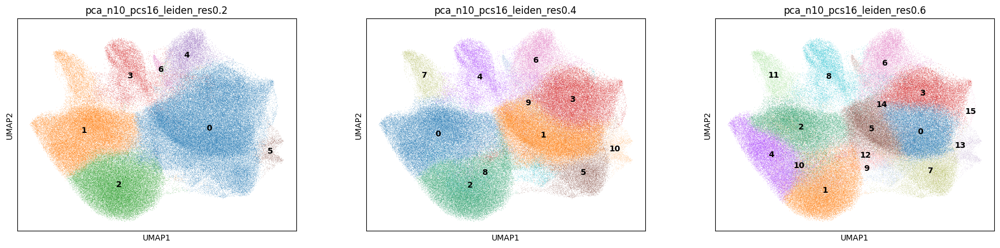

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['3', '5', '10', '1', '9', ..., '8', '0', '2', '4', '7']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [42]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '11'

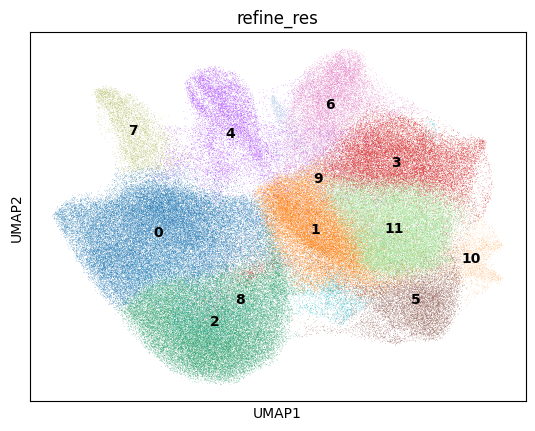

In [43]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [44]:
clustering_label = 'refine_res'

In [45]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

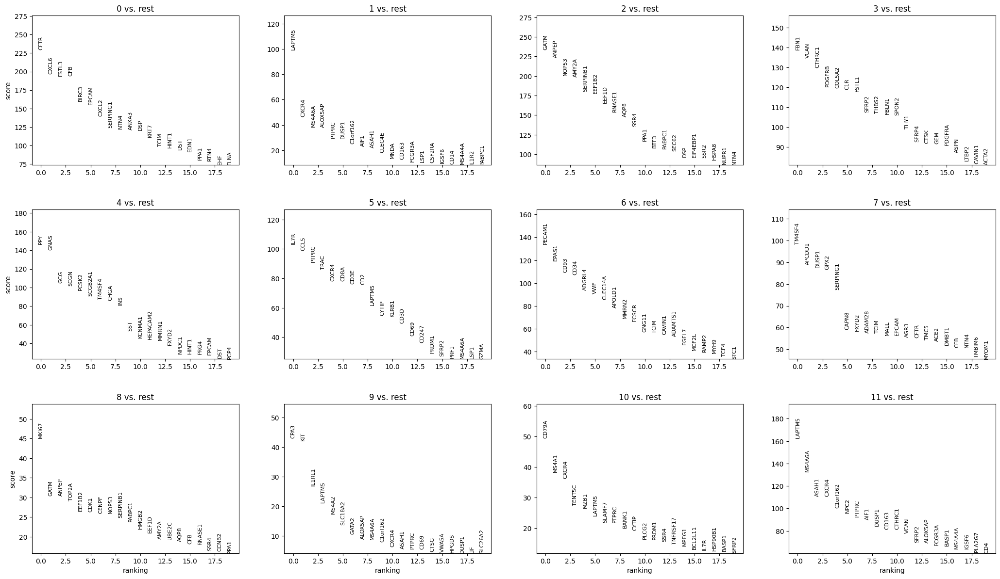

In [46]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [47]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [48]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [49]:
cluster_id = '0'

In [50]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Pancreatic_ductal_cell,cancer_cell,54.5
1,Epithelial,Pancreatic_epithelial_cell,normal_cell,27.4
2,Epithelial,High_proliferating_pancreatic_acinar_cell,normal_cell,7.3
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.3
4,NA,NA,NA,2.1


In [51]:
top_ranked_genes[cluster_id]

0     CFTR
1    CXCL6
2    FSTL3
3      CFB
4    BIRC3
5    EPCAM
6    CXCL2
Name: 0, dtype: object

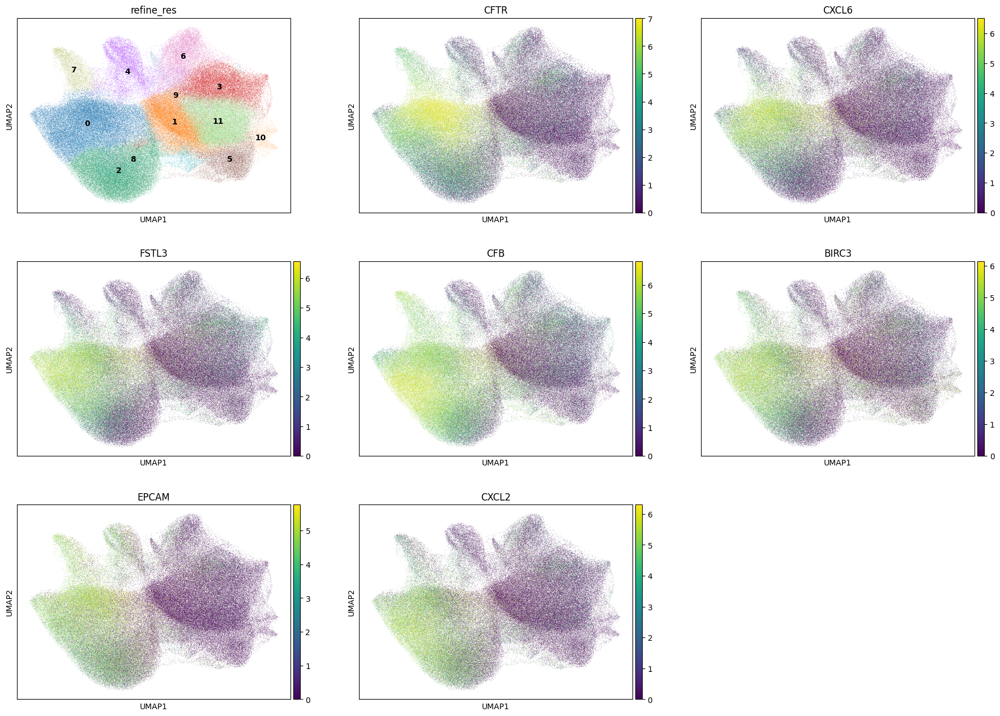

In [52]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [53]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 40882
Percentage of cells in cluster 0: 21.5


In [54]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pancreatic_epithelial_cell'

### 5.2. Cluster 1

In [55]:
cluster_id = '1'

In [56]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,32.5
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,27.4
2,Macrophage,Macrophage,normal_cell,19.4
3,Fibroblast,CAF,normal_cell,7.4
4,T,T,normal_cell,5.5


In [57]:
top_ranked_genes[cluster_id]

0      LAPTM5
1       CXCR4
2      MS4A6A
3     ALOX5AP
4       PTPRC
5       DUSP1
6    C1orf162
Name: 1, dtype: object

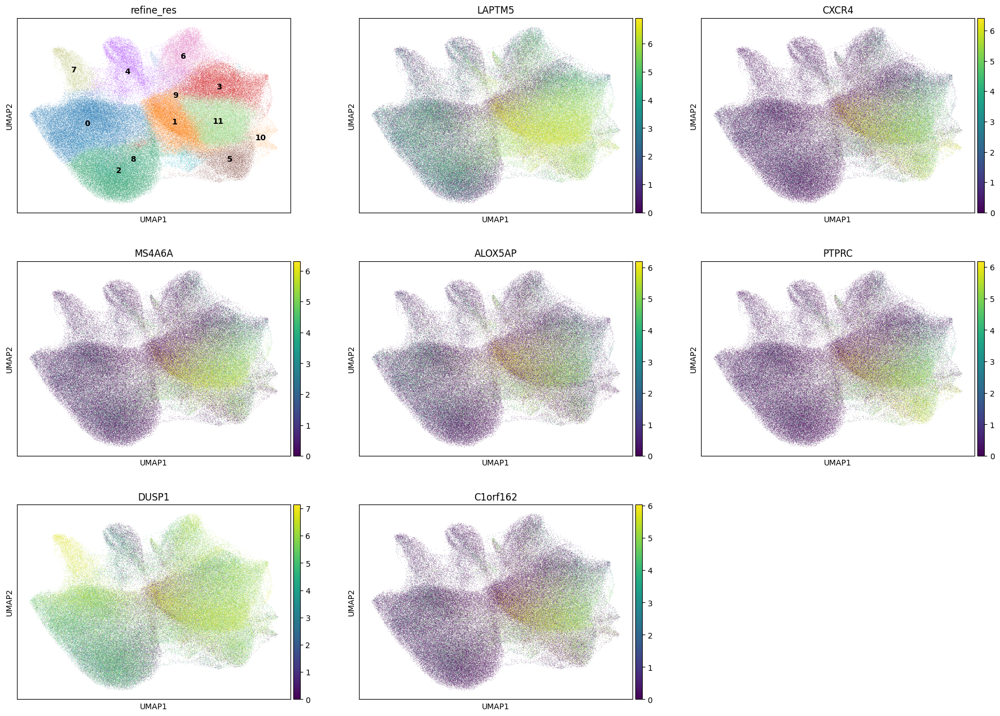

In [58]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [59]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 23277
Percentage of cells in cluster 1: 12.2


In [60]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.3. Cluster 2

In [61]:
cluster_id = '2'

In [62]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,High_proliferating_pancreatic_acinar_cell,normal_cell,70.4
1,Epithelial,Pancreatic_epithelial_cell,normal_cell,18.8
2,Macrophage,Macrophage,normal_cell,2.6
3,Epithelial,Pancreatic_ductal_cell,cancer_cell,2.6
4,Fibroblast,CAF,normal_cell,1.7


In [63]:
top_ranked_genes[cluster_id]

0        GATM
1       ANPEP
2       NOP53
3       AMY2A
4    SERPINB1
5      EEF1B2
6       EEF1D
Name: 2, dtype: object

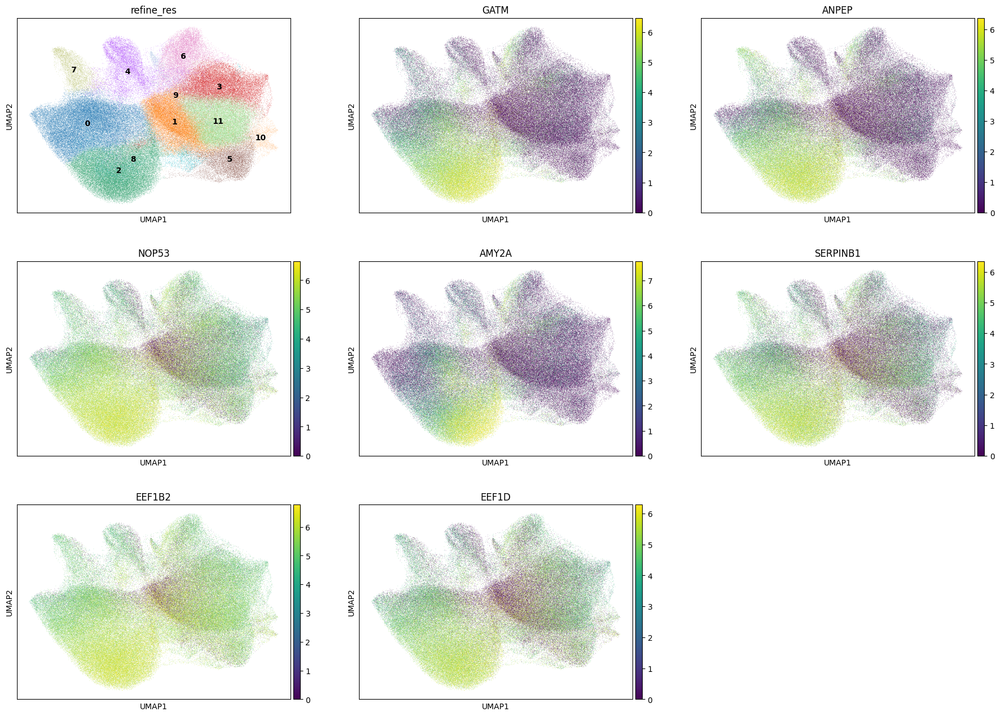

In [64]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [65]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 34808
Percentage of cells in cluster 2: 18.3


In [66]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pancreatic_acinar_cell'

### 5.4. Cluster 3

In [67]:
cluster_id = '3'

In [68]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,72.7
1,NA,NA,NA,7.9
2,Macrophage,Macrophage,normal_cell,5.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.7
4,T,T,normal_cell,3.1


In [69]:
top_ranked_genes[cluster_id]

0      FBN1
1      VCAN
2    CTHRC1
3    PDGFRB
4    COL5A2
5       C1R
6     FSTL1
Name: 3, dtype: object

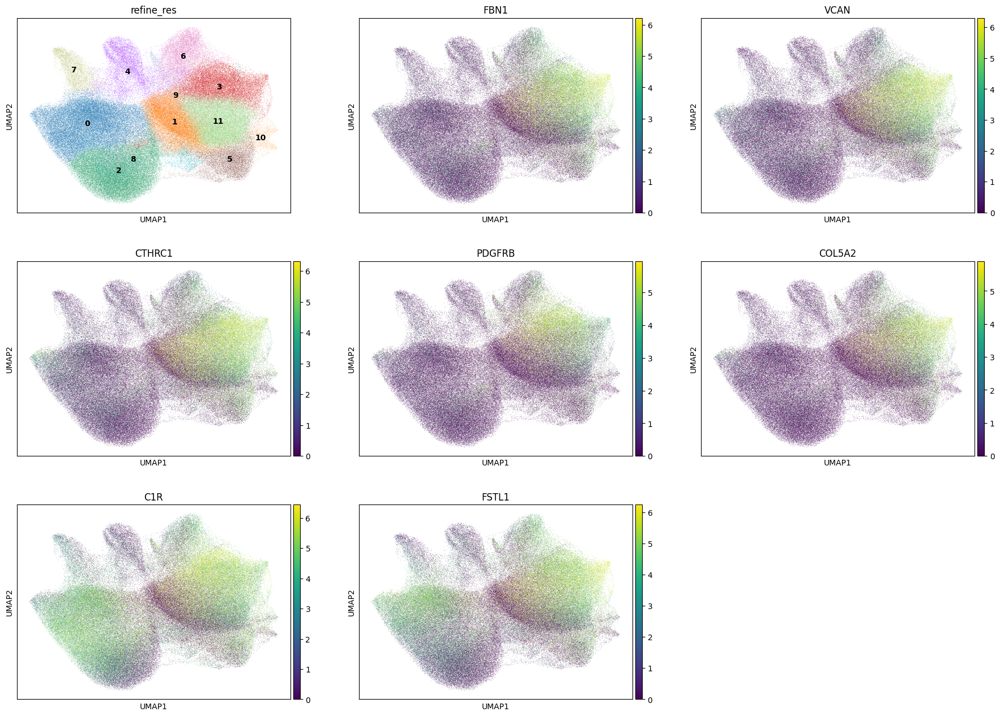

In [70]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [71]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 21228
Percentage of cells in cluster 3: 11.2


In [72]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.5. Cluster 4

In [73]:
cluster_id = '4'

In [74]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endocrine,Pancreatic_islet_cell,normal_cell,66.2
1,Fibroblast,CAF,normal_cell,8.9
2,Macrophage,Macrophage,normal_cell,4.2
3,Epithelial,High_proliferating_pancreatic_acinar_cell,normal_cell,3.9
4,NA,NA,NA,3.7


In [75]:
top_ranked_genes[cluster_id]

0        PPY
1       GNAS
2        GCG
3       SCGN
4      PCSK2
5    SCGB2A1
6     TM4SF4
Name: 4, dtype: object

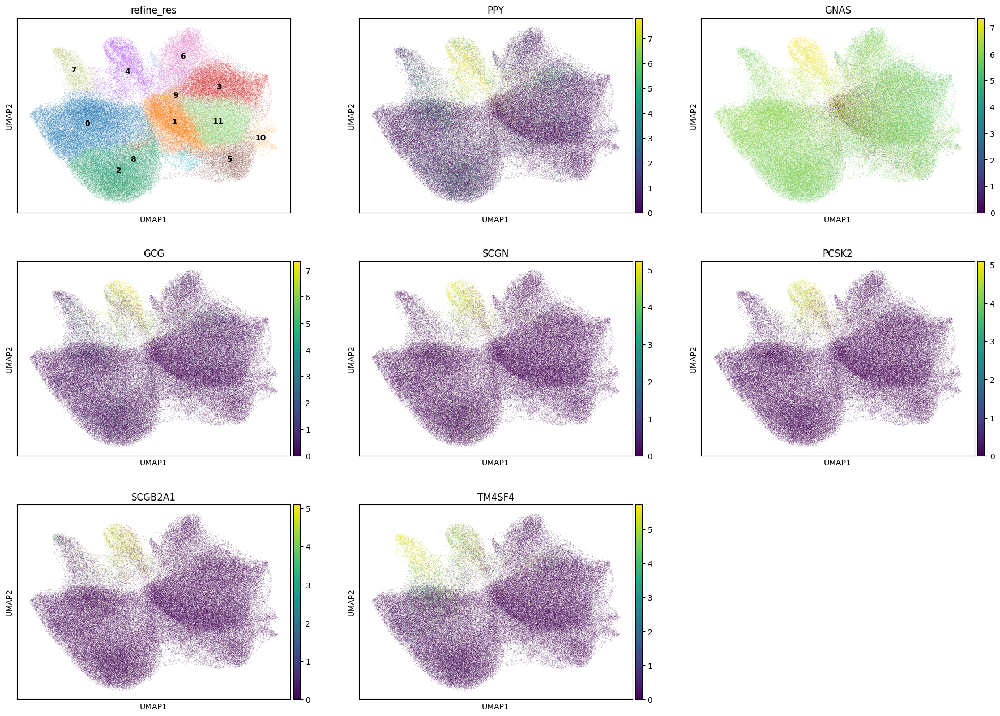

In [76]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [77]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 11224
Percentage of cells in cluster 4: 5.9


In [78]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endocrine'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pancreatic_islet_cell'

### 5.6. Cluster 5

In [79]:
cluster_id = '5'

In [80]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,83.1
1,NA,NA,NA,4.8
2,Macrophage,Macrophage,normal_cell,2.9
3,Fibroblast,CAF,normal_cell,2.3
4,B,B,normal_cell,2.0


In [81]:
top_ranked_genes[cluster_id]

0     IL7R
1     CCL5
2    PTPRC
3     TRAC
4    CXCR4
5     CD8A
6     CD3E
Name: 5, dtype: object

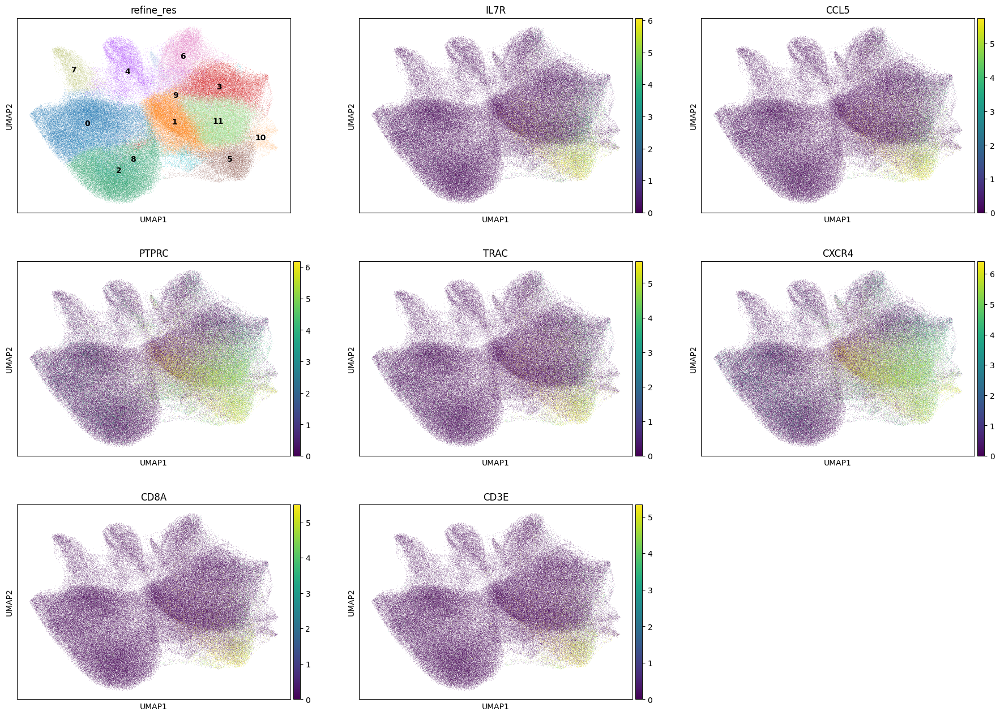

In [82]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [83]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 10328
Percentage of cells in cluster 5: 5.4


In [84]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.7. Cluster 6

In [85]:
cluster_id = '6'

In [86]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,67.0
1,Fibroblast,CAF,normal_cell,14.5
2,NA,NA,NA,4.5
3,Epithelial,High_proliferating_pancreatic_acinar_cell,normal_cell,3.8
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,3.2


In [87]:
top_ranked_genes[cluster_id]

0     PECAM1
1      EPAS1
2       CD93
3       CD34
4     ADGRL4
5        VWF
6    CLEC14A
Name: 6, dtype: object

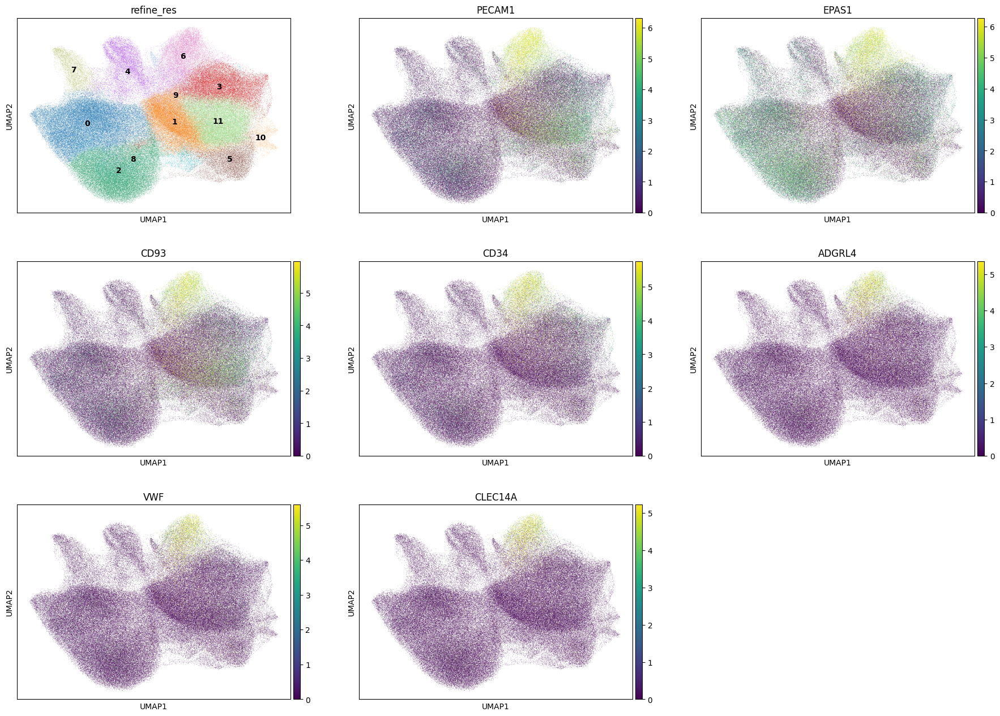

In [88]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [89]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 10380
Percentage of cells in cluster 6: 5.5


In [90]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.8. Cluster 7

In [91]:
cluster_id = '7'

In [92]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Pancreatic_ductal_cell,normal_cell,85.7
1,Epithelial,Pancreatic_ductal_cell,cancer_cell,4.0
2,Epithelial,Pancreatic_epithelial_cell,normal_cell,3.3
3,Fibroblast,CAF,normal_cell,2.5
4,Macrophage,Macrophage,normal_cell,1.3


In [93]:
top_ranked_genes[cluster_id]

0      TM4SF4
1      APCDD1
2       DUSP1
3        GPX2
4    SERPING1
5       CAPN8
6       FXYD2
Name: 7, dtype: object

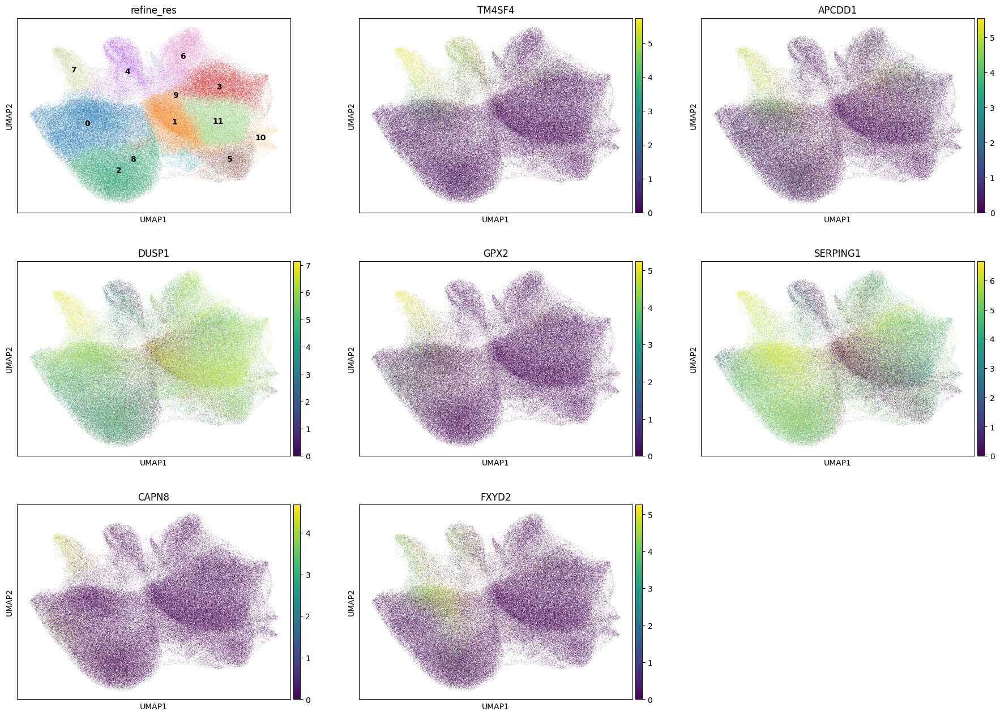

In [94]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [95]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 4280
Percentage of cells in cluster 7: 2.2


In [96]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pancreatic_ductal_cell'

### 5.9. Cluster 8

In [97]:
cluster_id = '8'

In [98]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,High_proliferating_pancreatic_acinar_cell,normal_cell,39.8
1,Macrophage,Macrophage,normal_cell,19.9
2,Epithelial,Pancreatic_epithelial_cell,normal_cell,9.3
3,Epithelial,Pancreatic_ductal_cell,cancer_cell,8.0
4,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,7.6


In [99]:
top_ranked_genes[cluster_id]

0     MKI67
1      GATM
2     ANPEP
3     TOP2A
4    EEF1B2
5      CDK1
6     CENPF
Name: 8, dtype: object

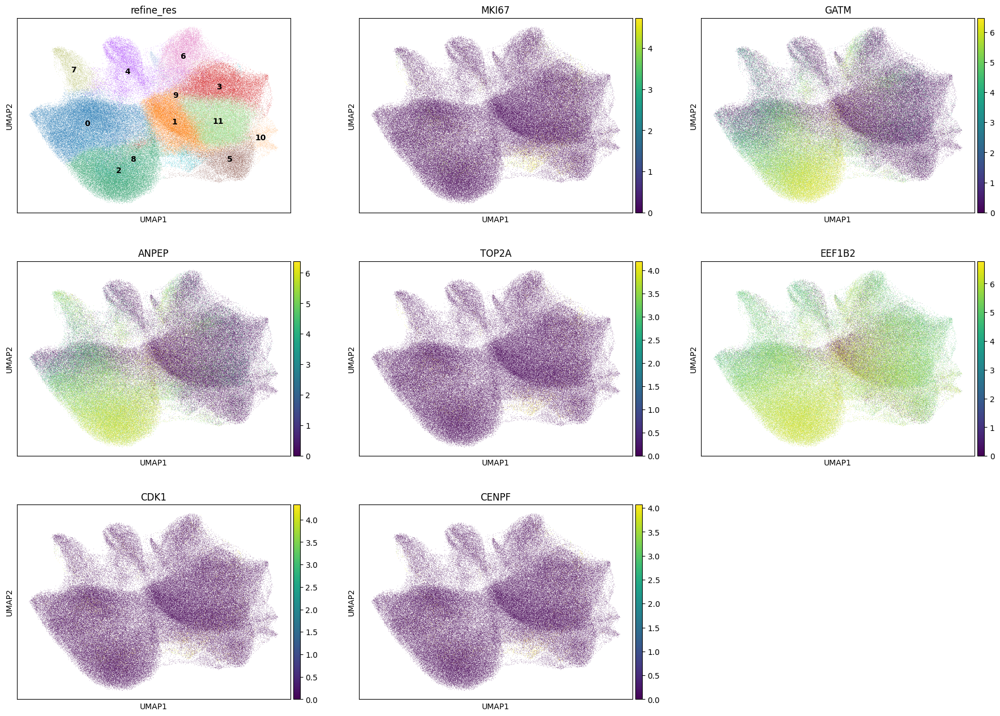

In [100]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [101]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 4175
Percentage of cells in cluster 8: 2.2


In [102]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Proliferating_pancreatic_epithelial_cell'

### 5.10. Cluster 9

In [103]:
cluster_id = '9'

In [104]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,48.1
1,NA,NA,NA,17.1
2,Fibroblast,CAF,normal_cell,9.0
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,8.8
4,Macrophage,Macrophage,normal_cell,7.3


In [105]:
top_ranked_genes[cluster_id]

0       CPA3
1        KIT
2     IL1RL1
3     LAPTM5
4      MS4A2
5    SLC18A2
6      GATA2
Name: 9, dtype: object

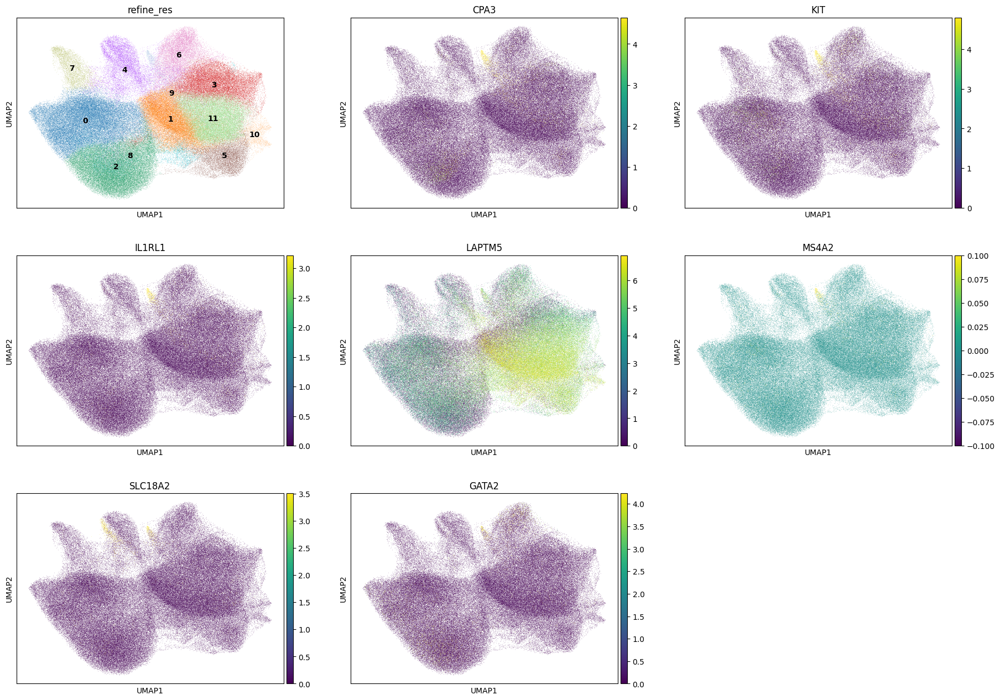

In [106]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [107]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 2454
Percentage of cells in cluster 9: 1.3


In [108]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

### 5.11. Cluster 10

In [109]:
cluster_id = '10'

In [110]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,B,B,normal_cell,69.4
1,Fibroblast,CAF,normal_cell,6.7
2,T,T,normal_cell,6.5
3,NA,NA,NA,5.9
4,Macrophage,Macrophage,normal_cell,4.4


In [111]:
top_ranked_genes[cluster_id]

0     CD79A
1     MS4A1
2     CXCR4
3    TENT5C
4      MZB1
5    LAPTM5
6    SLAMF7
Name: 10, dtype: object

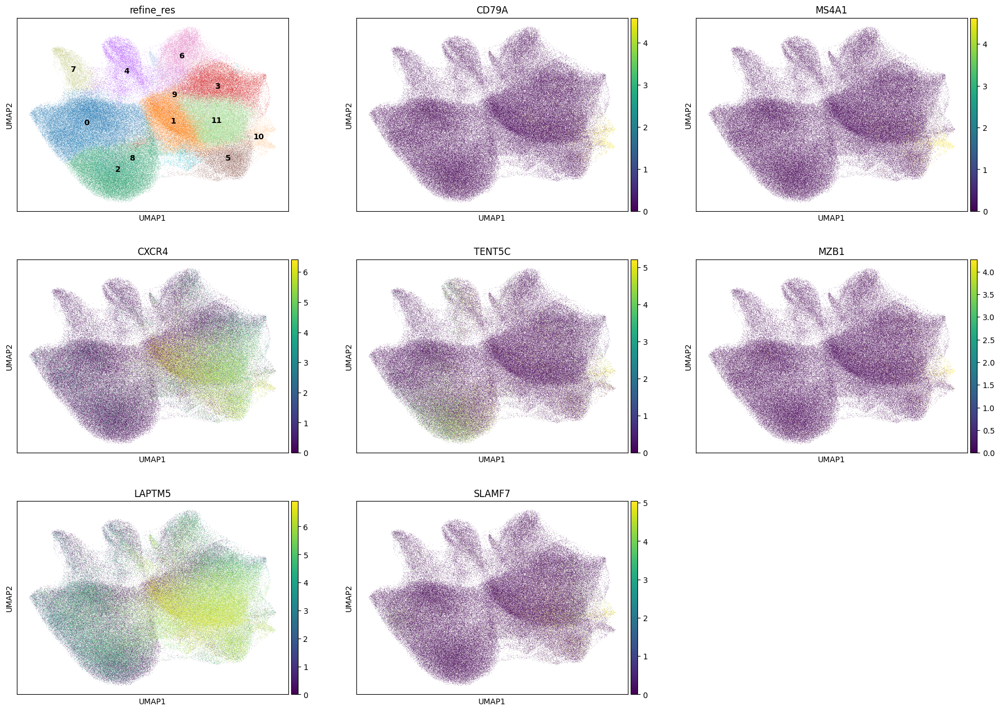

In [113]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [114]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 2365
Percentage of cells in cluster 10: 1.2


In [115]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'B'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'B'

### 5.12. Cluster 11

In [116]:
cluster_id = '11'

In [117]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Macrophage,Macrophage,normal_cell,51.8
1,Fibroblast,CAF,normal_cell,13.8
2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,13.4
3,NA,NA,NA,7.8
4,DC,DC,normal_cell,5.2


In [118]:
top_ranked_genes[cluster_id]

0      LAPTM5
1      MS4A6A
2       ASAH1
3       CXCR4
4    C1orf162
5        NPC2
6       PTPRC
Name: 11, dtype: object

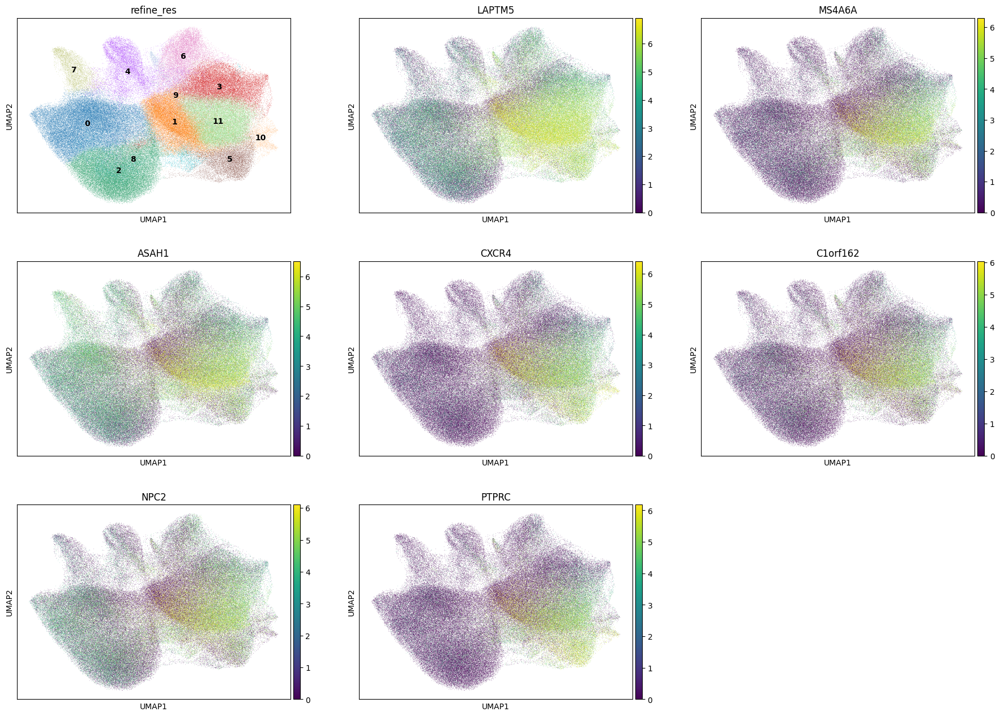

In [120]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [121]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 24893
Percentage of cells in cluster 11: 13.1


In [122]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

## 6. Cancer cells

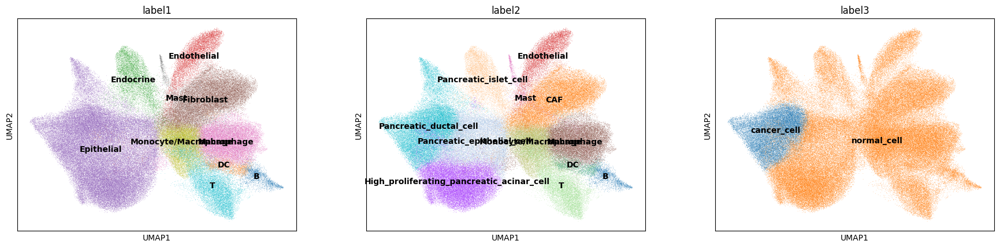

In [125]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

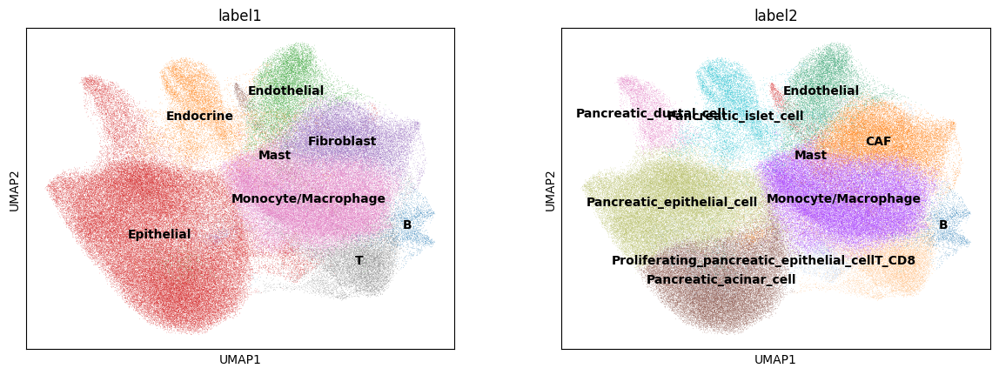

In [126]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [127]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial']), 'label3'] = 'cancer_cell'

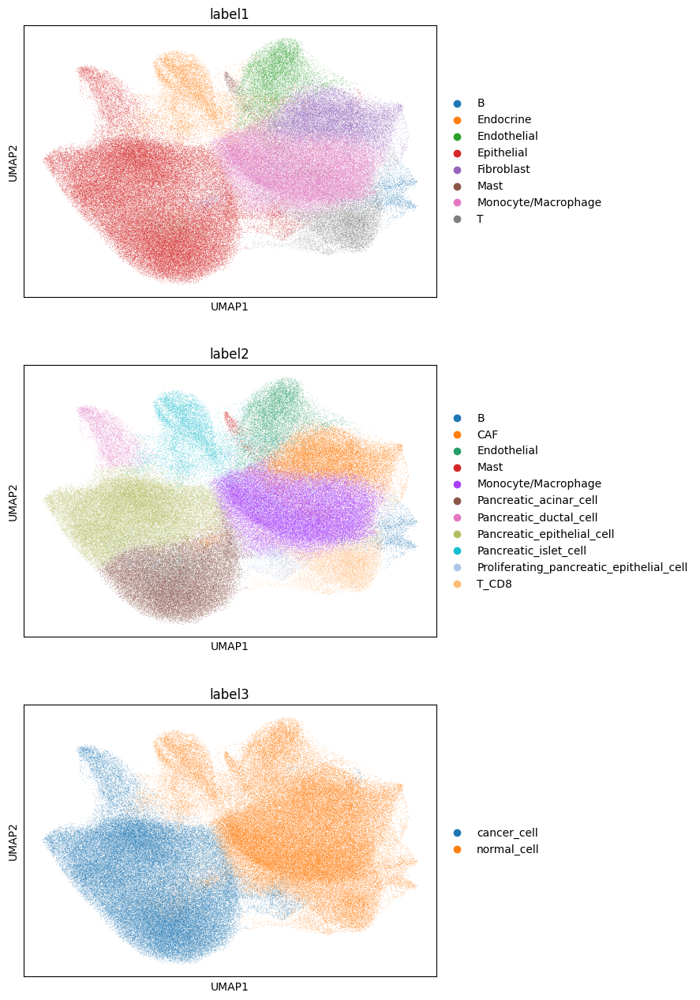

In [128]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [129]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,143,0,0,0,0,143,172.225944,8.037813,cell_labels,0,3,3,3,Fibroblast,CAF,normal_cell
1,aaaaaaab-1,112,0,0,0,0,112,334.517512,17.294844,cell_labels,0,5,7,5,T,T_CD8,normal_cell
2,aaaaaaac-1,81,0,0,0,0,81,180.263757,20.681563,cell_labels,5,10,13,10,B,B,normal_cell
3,aaaaaaad-1,30,0,0,0,0,30,43.891877,6.637969,cell_labels,0,1,9,1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
4,aaaaaaae-1,92,0,0,0,0,92,140.255318,27.093751,cell_labels,0,5,7,5,T,T_CD8,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
190960,aaacojpa-1,133,0,0,0,0,133,111.219848,24.429532,cell_labels,0,5,7,5,T,T_CD8,normal_cell
190961,aaacojpb-1,69,0,0,0,0,69,111.039223,16.888438,cell_labels,0,5,7,5,T,T_CD8,normal_cell
190962,aaacojpc-1,124,0,0,0,0,124,187.579069,23.120001,cell_labels,4,6,6,6,Endothelial,Endothelial,normal_cell
190963,aaacojpd-1,242,0,0,0,0,242,236.167196,22.262032,cell_labels,0,5,7,5,T,T_CD8,normal_cell


In [130]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")